# Benchmark GMM Dorso

### Outline
* generate expression matrix - ground truth (atlas, see normal droso tutorial)
* generate expression matrix - normal reconstruction (see normal droso tutorial)
* generate expression matrix - GMM (see "cleaning demonstration) - maybe different modes

* calculate similarity values of the matrixes
* plot them

Infos:

"dge_rep" mode: None (there are different possibilities, maybe try other later)


# Imports and Packages

In [25]:
# install
# pip install novosparc
# imports
from importlib import reload

import anndata
%matplotlib inline

import importlib.util
import sys
spec = importlib.util.spec_from_file_location("novosparc", "/home/vfs/PycharmProjects/rajewskyLab/novosparc/novosparc/__init__.py")
novosparc = importlib.util.module_from_spec(spec)
sys.modules["novosparc"] = novosparc
spec.loader.exec_module(novosparc)

# import novosparc
import os
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
plt.viridis()
from matplotlib.gridspec import GridSpec
# import altair as alt
from scipy.spatial.distance import cdist, squareform, pdist
from scipy.stats import ks_2samp
from scipy.stats import pearsonr
from scipy.stats import spearmanr
from scipy.stats import zscore
import sklearn
from sklearn.preprocessing import scale
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error
import random
random.seed(42)

# working directory
# os.chdir("/home/vfs/PycharmProjects/rajewskyLab/novosparc") # when I use this the notebook does not use the normal novosparc anymore - but when I put the notebooke physically in that directory everything works normally - where does this come from?

# test genes
pl_genes = ['sna', 'ken', 'eve','zen2','ImpE2']

# Reading expression data to scanpy AnnData (cells x genes)
data_dir = '../../novosparc/datasets/drosophila_scRNAseq/'
data_path = os.path.join(data_dir, 'dge_normalized.txt')
dataset = sc.read(data_path).T
gene_names = dataset.var.index.tolist()

num_cells, num_genes = dataset.shape # 1297 cells x 8924 genes

print('number of cells: %d' % num_cells)
print('number of genes: %d' % num_genes)
# optional: subset cells
num_cells = 1000
sc.pp.subsample(dataset, n_obs=num_cells)
# dge_rep mode
dge_rep = None # a representation of cells gene expression
# highly var genes
sc.pp.highly_variable_genes(dataset)
is_var_gene = dataset.var['highly_variable']
var_genes = list(is_var_gene.index[is_var_gene])

# atlas settings
atlas_dir = '../../novosparc/datasets/bdtnp/'
target_space_path = os.path.join(atlas_dir, 'geometry.txt')
locations = pd.read_csv(target_space_path, sep=' ')
num_locations = 3039 # coming from the spatial data
locations_apriori = locations[:num_locations][['xcoord', 'zcoord']].values

number of cells: 1297
number of genes: 8924


<Figure size 432x288 with 0 Axes>

In [3]:
## Expression Matrix - ground truth
locations = locations_apriori
atlas_path = os.path.join(atlas_dir, 'dge.txt')
atlas = sc.read(atlas_path)
atlas_genes = atlas.var.index.tolist()
atlas.obsm['spatial'] = locations

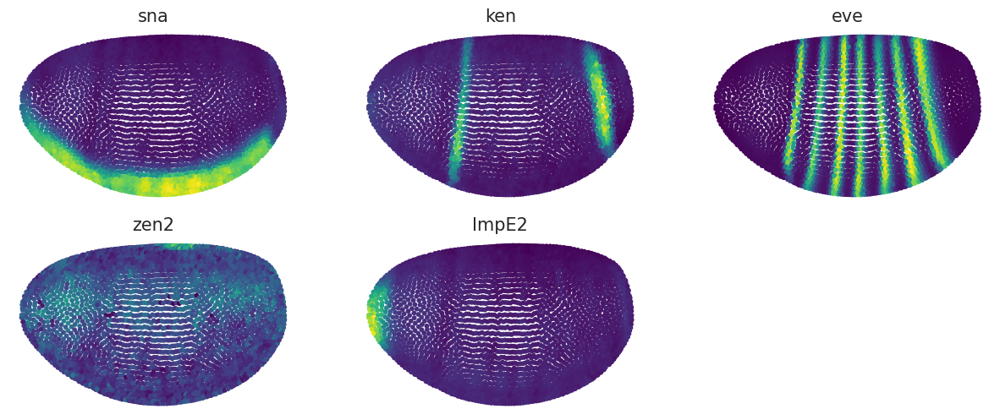

<Figure size 432x288 with 0 Axes>

In [4]:
# test
# novosparc.pl.embedding(atlas, pl_genes)

In [5]:
expmtrx_truth = atlas.X

# # min-max normalization
# expmtrx_truth_normed = (expmtrx_truth - np.min(expmtrx_truth))/ (np.max(expmtrx_truth) - np.min(expmtrx_truth))

In [6]:
# zscore
expmtrx_truth_normed = zscore(expmtrx_truth)
expmtrx_truth_normed.shape

(3039, 84)

 ## Expression Matrix - basic reconstruction

In [7]:
# calculate cost matrix
# params for smooth cost
num_neighbors_s = num_neighbors_t = 5

# params for linear cost
markers = list(set(atlas_genes).intersection(gene_names))
atlas_matrix = atlas.to_df()[markers].values
markers_idx = pd.DataFrame({'markers_idx': np.arange(num_genes)}, index=gene_names)
markers_to_use = np.concatenate(markers_idx.loc[markers].values)

# construct tissue object
tissue = novosparc.cm.Tissue(dataset=dataset, locations=locations_apriori)


tissue.setup_reconstruction(atlas_matrix=atlas_matrix,
                            markers_to_use=markers_to_use,
                            num_neighbors_s=num_neighbors_s,
                            num_neighbors_t=num_neighbors_t)

# dge_rep = None
tissue.setup_smooth_costs(dge_rep=dge_rep, num_neighbors_s=num_neighbors_s, num_neighbors_t=num_neighbors_t)

# compute optimal transport of cells to locations
alpha_linear = 0.8
epsilon = 5e-3
# tissue.dge = sparse.csr_matrix(tissue.dge)
tissue.reconstruct(alpha_linear=alpha_linear, epsilon=epsilon)

# reconstructed expression of individual genes
sdge = tissue.sdge
dataset_reconst = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
dataset_reconst.obsm['spatial'] = locations_apriori

Setting up for reconstruction ... done ( 4.36 seconds )
Setting up for reconstruction ... done ( 4.49 seconds )
Reconstructing spatial information with 84 markers: 1000 cells and 3039 locations ... 
Trying with epsilon: 5.00e-03
Trying with epsilon: 5.00e-03


/tmp/ipykernel_8980/2636297891.py:31: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset_reconst = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [8]:
# plt.hist(tissue.gw)

In [9]:
# test
# novosparc.pl.embedding(dataset_reconst, pl_genes)

In [10]:
subset_cols = []
for i, gene in enumerate(atlas_genes):
    if gene in dataset_reconst.var_names:
        subset_cols.append(np.asarray(dataset_reconst[:, gene].X).reshape(-1, 1))
exprmtrx_simplerecon = np.concatenate(subset_cols, axis=1)

In [11]:
# # min-max normalization
# exprmtrx_simplerecon_normed = (exprmtrx_simplerecon - np.min(exprmtrx_simplerecon))/ (np.max(exprmtrx_simplerecon) - np.min(exprmtrx_simplerecon))

In [12]:
# zscore
exprmtrx_simplerecon_normed = zscore(exprmtrx_simplerecon)
exprmtrx_simplerecon_normed.shape

(3039, 84)

In [13]:
type(atlas_genes)

list

## Expression Matrix- basic cleaning

ToDo: I should think about how to do this in a function so I can do this for multiple settings. Outputting a list of expression matrixes, which I then can use for all the calculations and stuff


In [14]:
# construct tissue object
tissue_postcleaned = novosparc.cm.Tissue(dataset=dataset, locations=locations_apriori)

# alternative 1: setup both assumptions
tissue_postcleaned.setup_reconstruction(atlas_matrix=atlas_matrix,
                            markers_to_use=markers_to_use,
                            num_neighbors_s=num_neighbors_s,
                            num_neighbors_t=num_neighbors_t)

tissue_postcleaned.setup_smooth_costs(dge_rep=dge_rep, num_neighbors_s=num_neighbors_s, num_neighbors_t=num_neighbors_t)

# compute optimal transport of cells to locations
alpha_linear = 0.8
epsilon = 5e-3
# tissue.dge = sparse.csr_matrix(tissue.dge)
tissue_postcleaned.reconstruct(alpha_linear=alpha_linear, epsilon=epsilon)

# reconstructed expression of individual genes
sdge = tissue_postcleaned.sdge

dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
dataset_reconst_postcleaned.obsm['spatial'] = locations_apriori
# GMM
tissue_postcleaned.cleaning_expression_data(dataset_reconst_postcleaned,tissue_postcleaned.sdge.T,normalization='zscore', selected_genes=atlas_genes)

# reconstructed expression of individual genes
sdge_postcleaned = tissue_postcleaned.cleaned_dge
dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge_postcleaned, columns=gene_names))
dataset_reconst_postcleaned.obsm['spatial'] = locations_apriori

Setting up for reconstruction ... done ( 3.72 seconds )
Setting up for reconstruction ... done ( 3.72 seconds )
Reconstructing spatial information with 84 markers: 1000 cells and 3039 locations ... 
Trying with epsilon: 5.00e-03
Trying with epsilon: 5.00e-03


/tmp/ipykernel_8980/2647430811.py:21: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset_reconst_postcleaned = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converge

In [15]:
# test
# novosparc.pl.embedding(dataset_reconst_postcleaned, pl_genes)

In [16]:
subset_cols = []
for i, gene in enumerate(atlas_genes):
    if gene in dataset_reconst_postcleaned.var_names:
        subset_cols.append(np.asarray(dataset_reconst_postcleaned[:, gene].X).reshape(-1, 1))
exprmtrx_recon_defaultGMM = np.concatenate(subset_cols, axis=1)

In [17]:
# min-max normalization
# exprmtrx_recon_defaultGMM_normed = (exprmtrx_recon_defaultGMM - np.min(exprmtrx_recon_defaultGMM))/ (np.max(exprmtrx_recon_defaultGMM) - np.min(exprmtrx_recon_defaultGMM))

In [18]:
# zscore norm
# should be already normalized
exprmtrx_recon_defaultGMM_normed = exprmtrx_recon_defaultGMM

In [19]:

exprmtrx_recon_defaultGMM_normed.shape

(3039, 84)

## Merging matrix and scale together

In [57]:
exprssn_mtrx_all = np.concatenate((expmtrx_truth, exprmtrx_simplerecon, exprmtrx_recon_defaultGMM), axis=1)
exprssn_mtrx_all_scaled = scale(exprssn_mtrx_all)
expmtrx_truth_scaled = exprssn_mtrx_all_scaled[:,0:84]
exprmtrx_simplerecon_scaled = exprssn_mtrx_all_scaled[:,84:168]
exprmtrx_recon_defaultGMM_scaled = exprssn_mtrx_all_scaled[:,168:252]

/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/preprocessing/_data.py:239: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/sklearn/preprocessing/_data.py:258: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


# Comparing results <a class="anchor" id="comparing_results"></a>
ToDo: also make this a function you can loop though just plotting the results in the end

## Correlation Measurement Functions <a class="anchor" id="corre_functions"></a>

In [65]:
def mse(actual, pred):
    actual, pred = np.array(actual), np.array(pred)
    return np.square(np.subtract(actual,pred)).mean()

def rmse(actual, pred):
    actual, pred = np.array(actual), np.array(pred)
    return np.sqrt(np.square(np.subtract(actual,pred)).mean())

def mean_pearson(actual, pred):
    r_per_gene = []
    for i in range(actual.shape[1]):
        r_score,p_value = pearsonr(actual[:,i],
                 pred[:,i])
        r_per_gene.append(r_score) # assumption all p-values are acceptable ToDo: make version with filtering for p-values
    return r_per_gene, np.mean(r_per_gene)

def mean_spearman(actual, pred):
    r_per_gene = []
    for i in range(actual.shape[1]):
        r_score,p_value = spearmanr(actual[:,i],
                 pred[:,i])
        r_per_gene.append(r_score) # assumption all p-values are acceptable ToDo: make version with filtering for p-values
    return r_per_gene, np.mean(r_per_gene)

def box_swarm_label(plot_df, score_name, single_dfs=None):
    ## plot_df must contain columns "gene", "r score (pearson)", and "method" (being the  reconstruction/cleaning)

    figure(figsize=(11, 12), dpi=80)

    sns.boxplot(x="method", y=score_name, data=plot_df, whis=np.inf)
    sns.swarmplot(x="method", y=score_name, data=plot_df,
                  palette=["crimson","indigo"])

    if single_dfs:
        for counter, single_df in enumerate(single_dfs):

            for x,y, label in zip([counter]*len(plot_df), single_df[score_name], single_df["gene"]):
                plt.text(x = x + 0.1, y = y,
                         s = label,
                         rotation= 45)
    plt.show()

def filter_matrix_for_genes(dataframe, gene_list):
    filtered_df = dataframe[dataframe.gene.isin(gene_list)]
    return filtered_df

def mean_ssim(actual, pred):
    ssim_per_gene = []
    for i in range(actual.shape[1]):
        ssim_score= ssim(actual[:,i],pred[:,i],
                         data_range= pred[:,i].max() -  pred[:,i].min())
        ssim_per_gene.append(ssim_score) # assumption all p-values are acceptable ToDo: make version with filtering for p-values
    return ssim_per_gene, np.mean(ssim_per_gene)
# def invest_plot_for_correlations(truth_df, list_of_expression_mtrx, list_of_special_genes, list_of_score_cutoffs)
# ToDo
plt.viridis()

<Figure size 432x288 with 0 Axes>

## Pearson Correlation

In [60]:
plt.viridis()
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_pearson(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
pearson_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (pearson)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_pearson(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
pearson_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (pearson)","method"])

pearson_corre_plt = pd.concat([pearson_corre_reconstruction,pearson_corre_cleaned])

<Figure size 432x288 with 0 Axes>

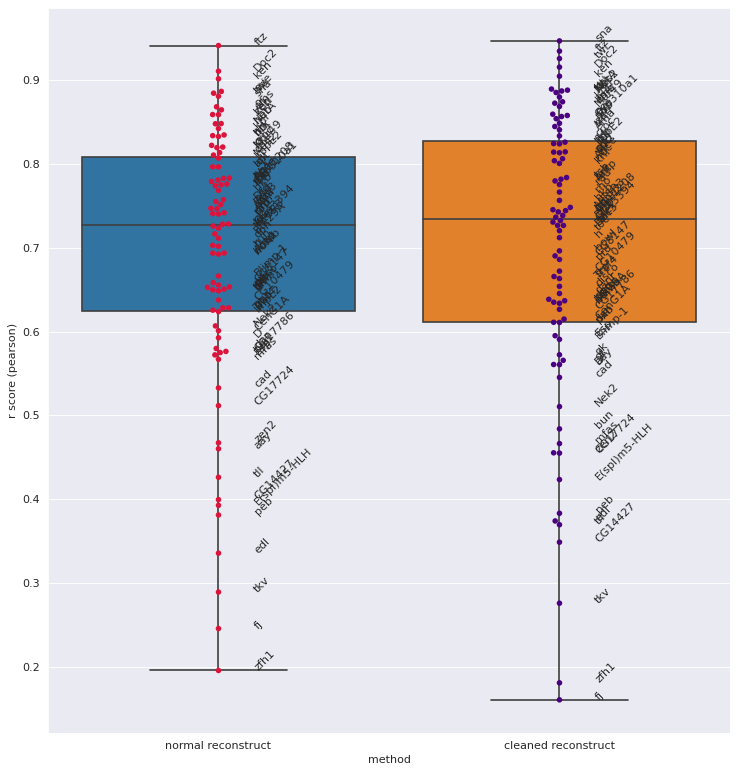

In [61]:
box_swarm_label(pearson_corre_plt,"r score (pearson)",
                [pearson_corre_reconstruction,pearson_corre_cleaned])

<Figure size 432x288 with 0 Axes>

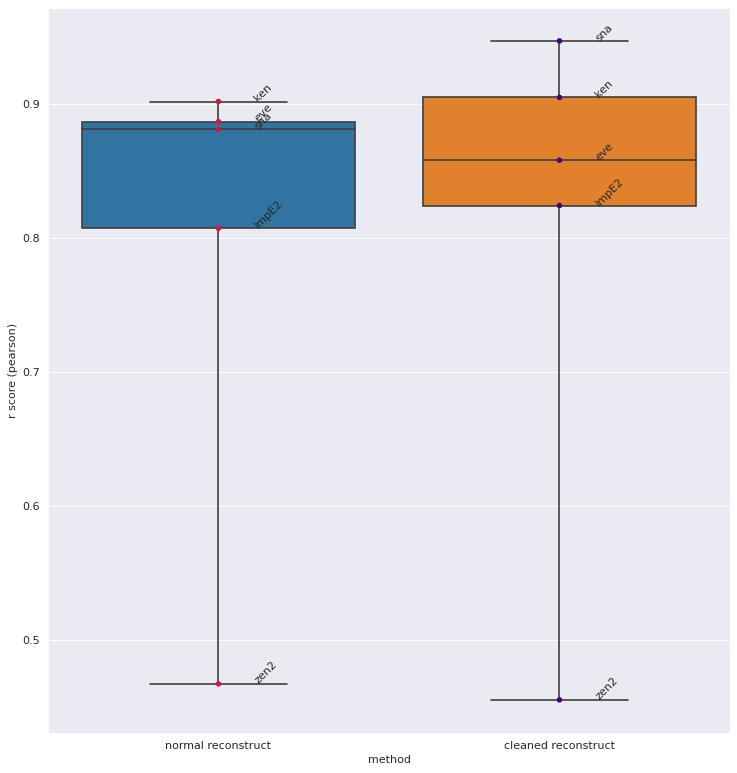

In [62]:
plt.viridis()
from matplotlib.gridspec import GridSpec
# plotting genes of interest
invest_genes1 = pl_genes = ['sna', 'ken', 'eve','zen2','ImpE2']
# high scoring genes
high_score_genes = list(pearson_corre_reconstruction[pearson_corre_reconstruction["r score (pearson)"] >=0.7].gene)
# low scoring genes
low_score_genes = list(pearson_corre_reconstruction[pearson_corre_reconstruction["r score (pearson)"] <=0.5].gene)

box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,invest_genes1),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,invest_genes1),
                filter_matrix_for_genes(pearson_corre_cleaned,invest_genes1)])
# print("ground truth")
# novosparc.pl.embedding(atlas, invest_genes1)
# print("reconstruction")
# novosparc.pl.embedding(dataset_reconst, invest_genes1)
# print("cleaning")
# novosparc.pl.embedding(dataset_reconst_postcleaned, invest_genes1)

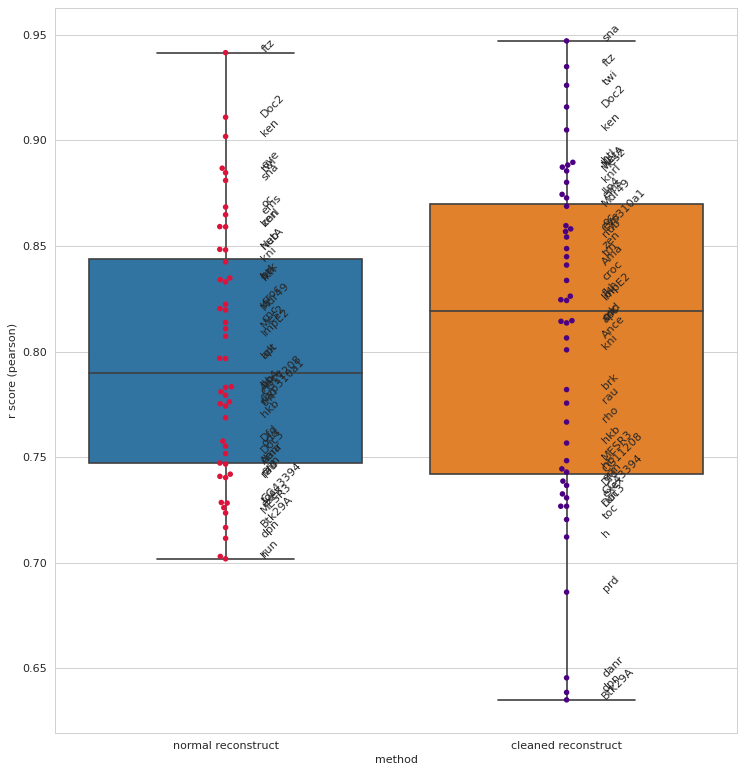

ground truth


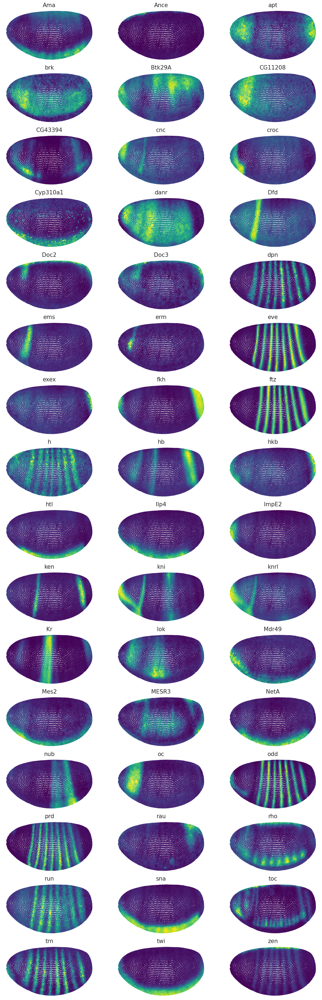

reconstruction


<Figure size 432x288 with 0 Axes>

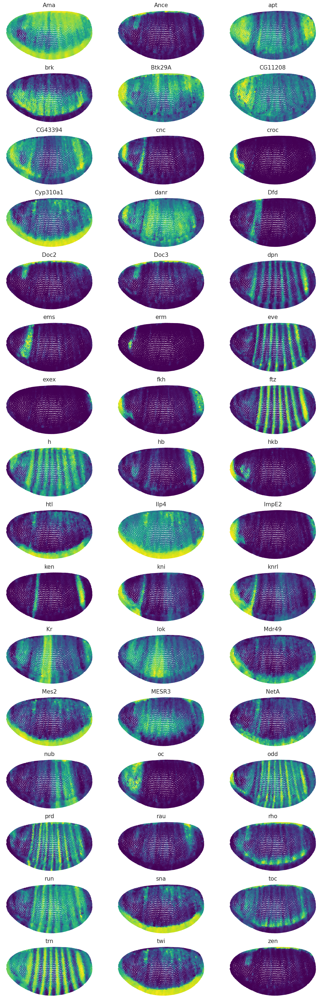

cleaning


<Figure size 432x288 with 0 Axes>

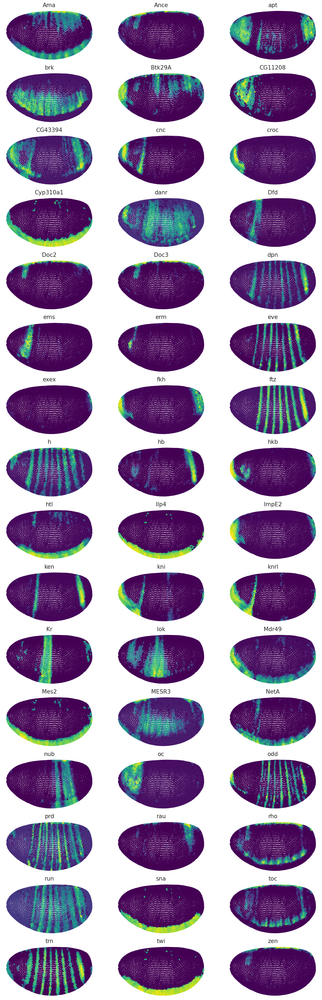

<Figure size 432x288 with 0 Axes>

In [67]:
# high scoring genes
box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,high_score_genes),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,high_score_genes),
                filter_matrix_for_genes(pearson_corre_cleaned,high_score_genes)])
print("ground truth")
novosparc.pl.embedding(atlas, high_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, high_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, high_score_genes)

<Figure size 432x288 with 0 Axes>

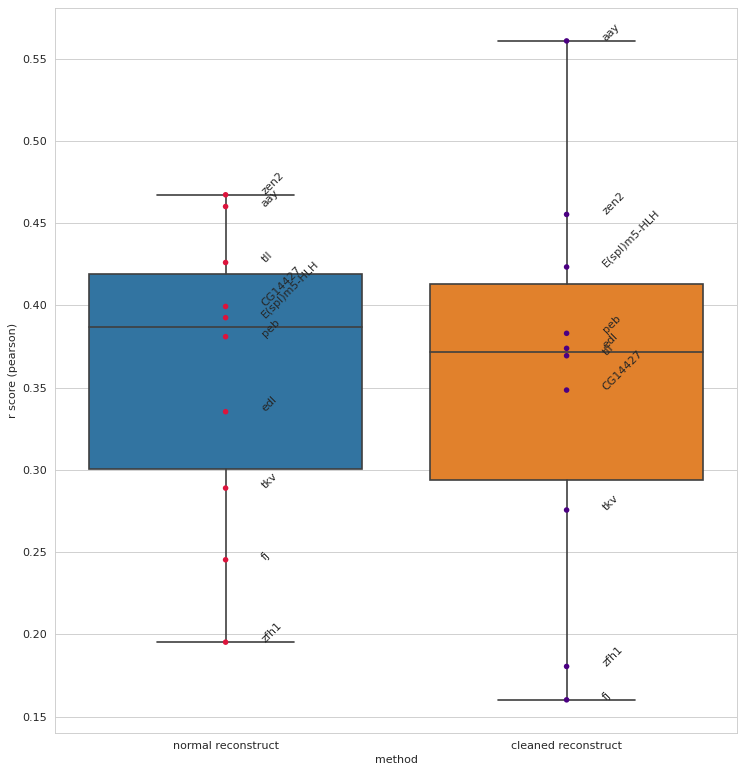

ground truth


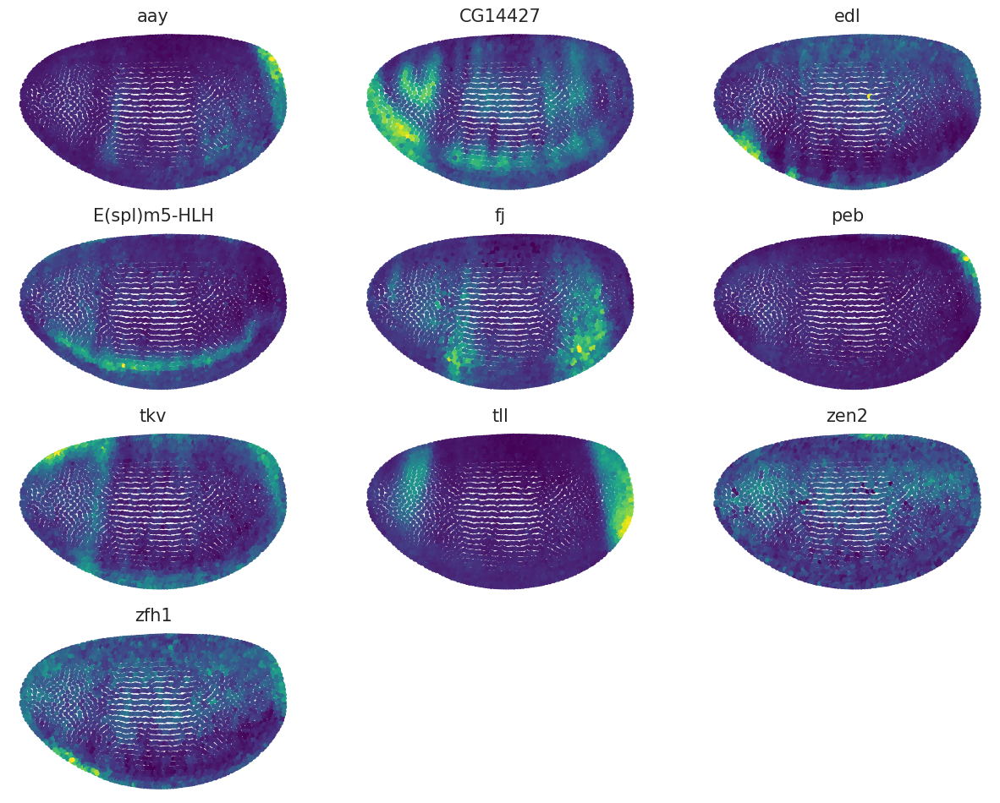

reconstruction


<Figure size 432x288 with 0 Axes>

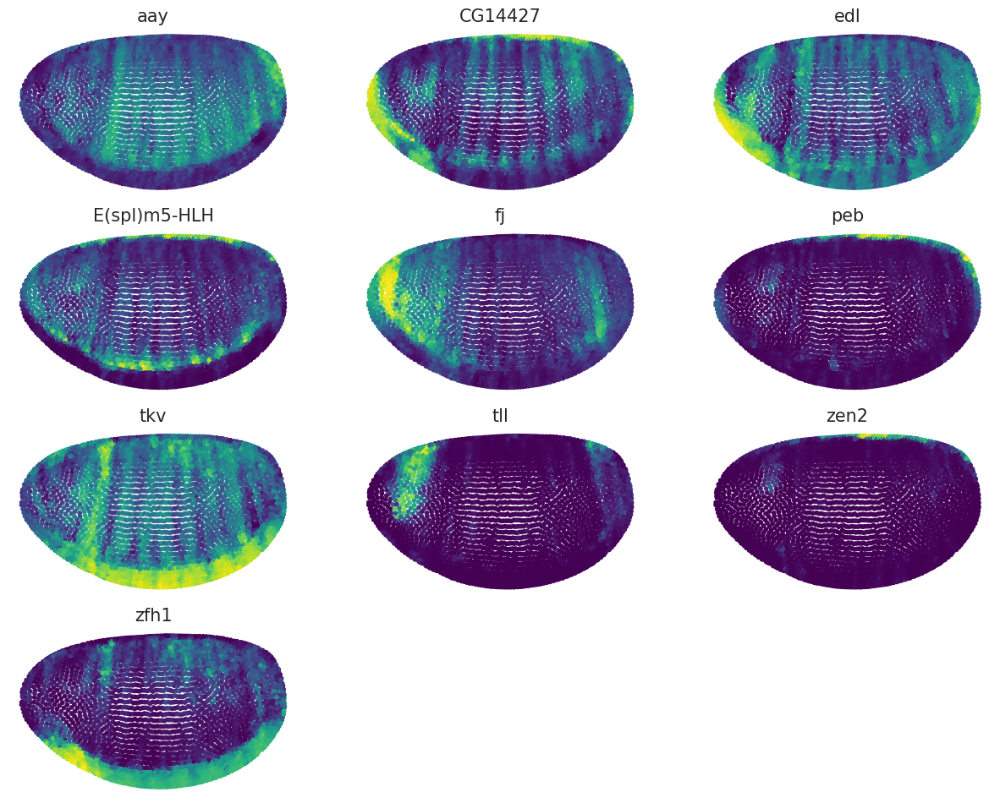

cleaning


<Figure size 432x288 with 0 Axes>

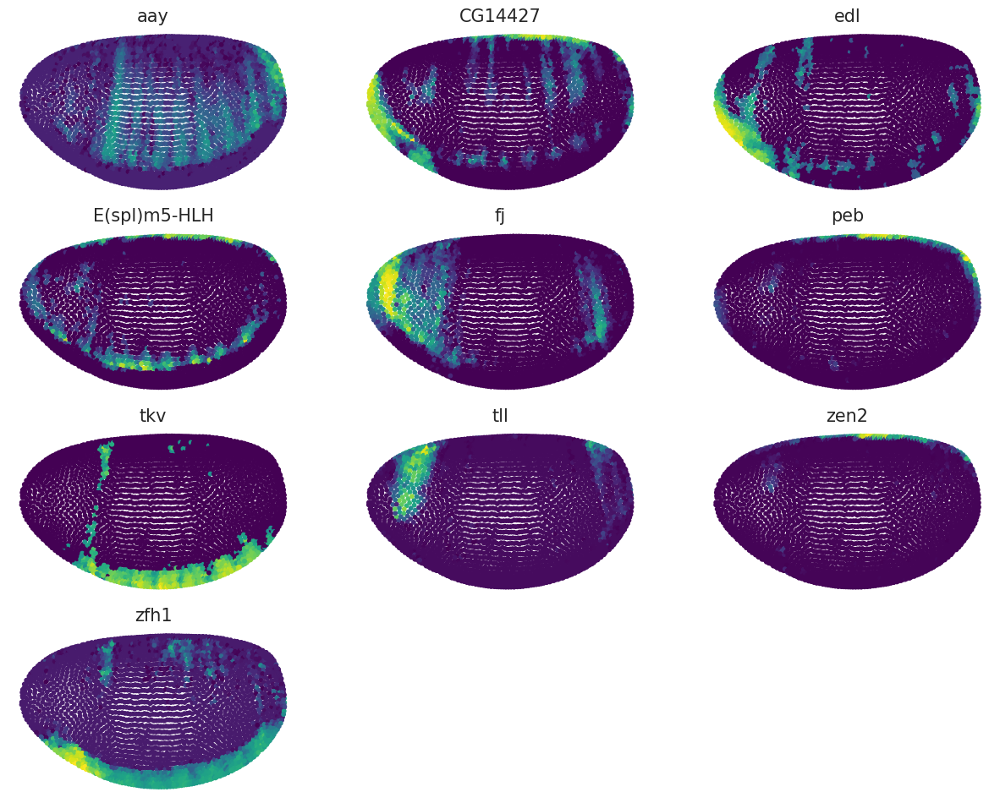

<Figure size 432x288 with 0 Axes>

In [68]:
plt.viridis()
# low scoring genes
box_swarm_label(filter_matrix_for_genes(pearson_corre_plt,low_score_genes),
                "r score (pearson)",
                [filter_matrix_for_genes(pearson_corre_reconstruction,low_score_genes),
                filter_matrix_for_genes(pearson_corre_cleaned,low_score_genes)])

print("ground truth")
novosparc.pl.embedding(atlas, low_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, low_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, low_score_genes)

## Spearman correlation

Following Artürs advice I will use Spearman over Pearson as it appears to be better for gene expression stuff. His explanaiton: "the reason for that is the continuity assumption of euclidean plus the high dimensionality of the gene panel"

<Figure size 432x288 with 0 Axes>

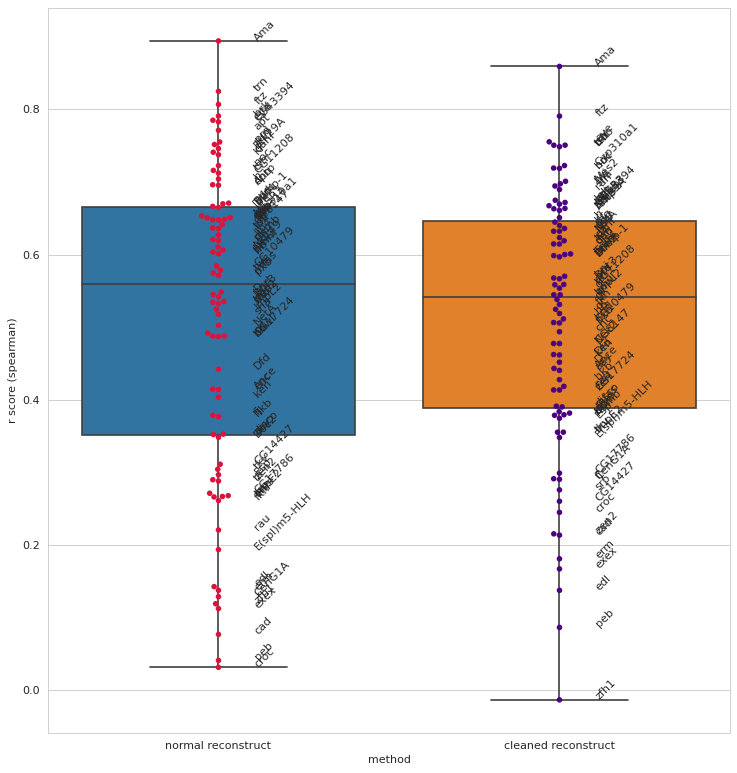

In [69]:
plt.viridis()
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_spearman(expmtrx_truth_normed, exprmtrx_simplerecon_normed)
spearman_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (spearman)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_spearman(expmtrx_truth_normed, exprmtrx_recon_defaultGMM_normed)
spearman_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (spearman)","method"])

spearman_corre_plt = pd.concat([spearman_corre_reconstruction,spearman_corre_cleaned])
box_swarm_label(spearman_corre_plt,
                "r score (spearman)",
                [spearman_corre_reconstruction,spearman_corre_cleaned])

In [70]:
spearman_corre_plt.loc[spearman_corre_plt['gene'] == "apt"]

,gene,r score (spearman),method
4,apt,0.771144,normal reconstruct
4,apt,0.671755,cleaned reconstruct


In [71]:

# plotting genes of interest
invest_genes1 = pl_genes = ['sna', 'ken', 'eve', 'zen2', 'ImpE2']
# high scoring genes
high_score_genes = list(spearman_corre_reconstruction[spearman_corre_reconstruction["r score (spearman)"] >= 0.7].gene)
# low scoring genes
low_score_genes = list(spearman_corre_reconstruction[spearman_corre_reconstruction["r score (spearman)"] <= 0.5].gene)
high_score_genes

['Ama',
 'apt',
 'brk',
 'Btk29A',
 'CG11208',
 'CG43394',
 'danr',
 'eve',
 'ftz',
 'h',
 'Kr',
 'noc',
 'prd',
 'run',
 'trn',
 'tsh']

paper plotting genes


<Figure size 432x288 with 0 Axes>

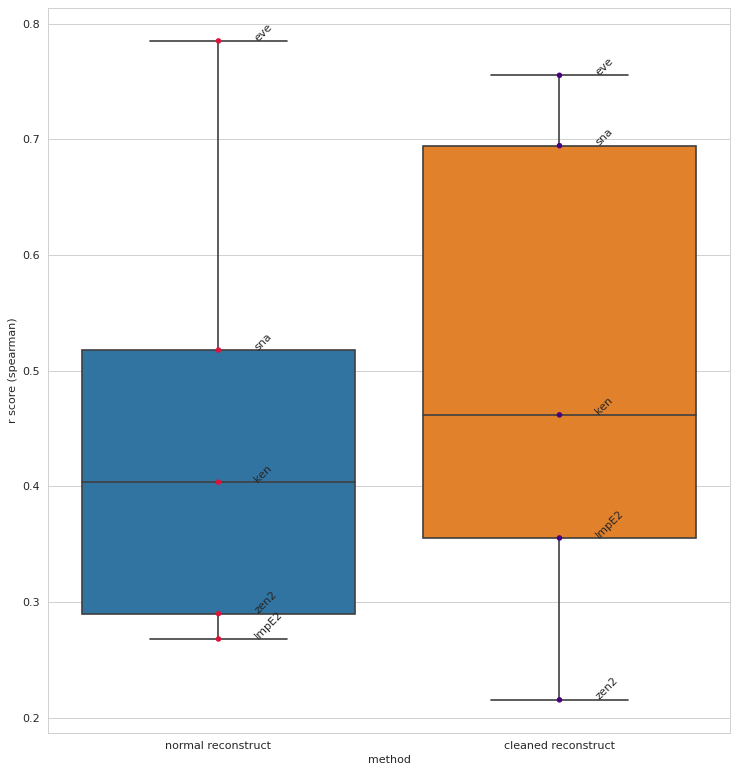

ground truth


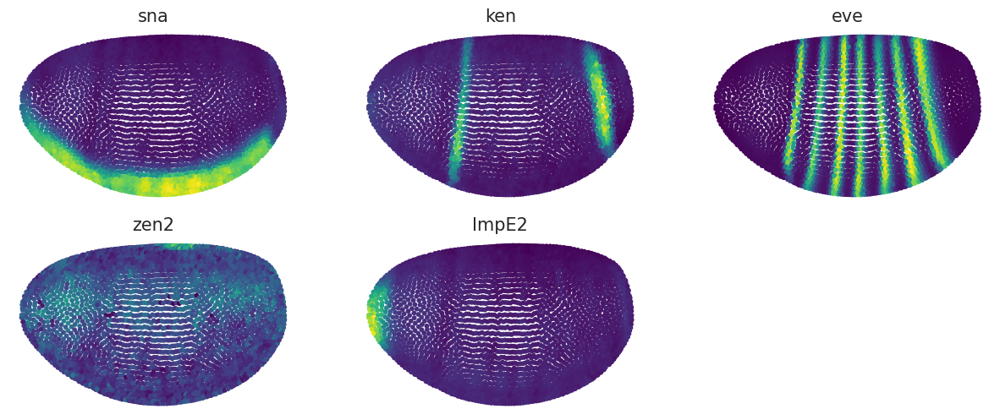

reconstruction


<Figure size 432x288 with 0 Axes>

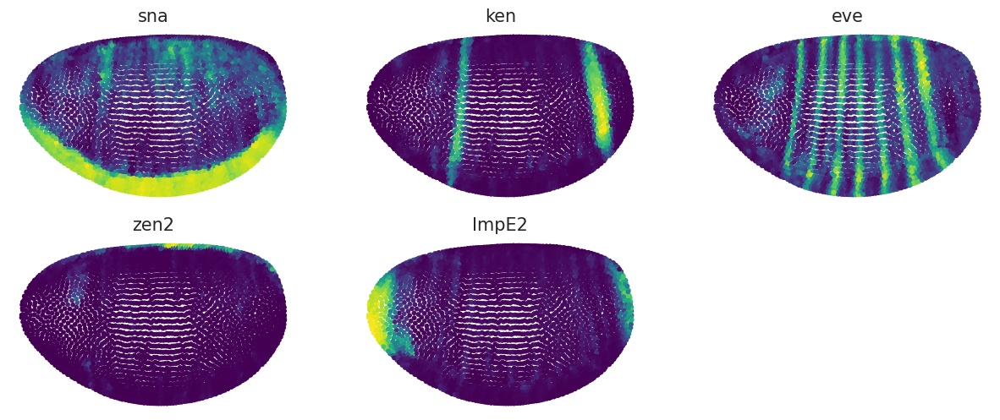

cleaning


<Figure size 432x288 with 0 Axes>

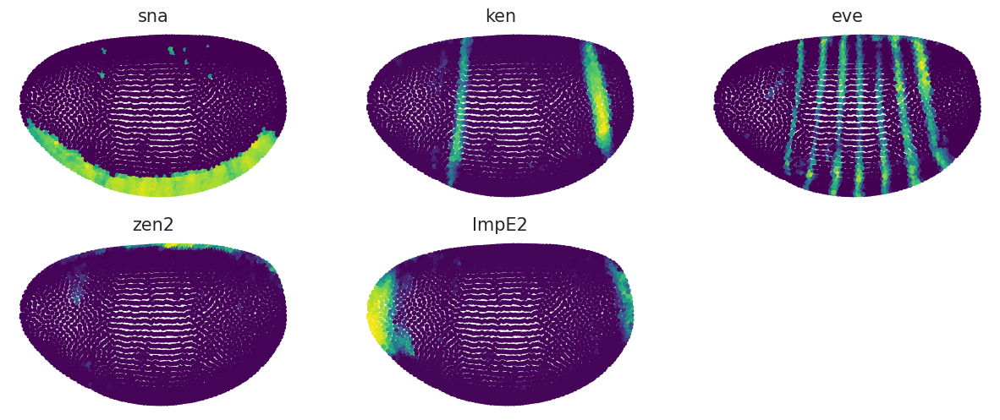

high scoring genes


<Figure size 432x288 with 0 Axes>

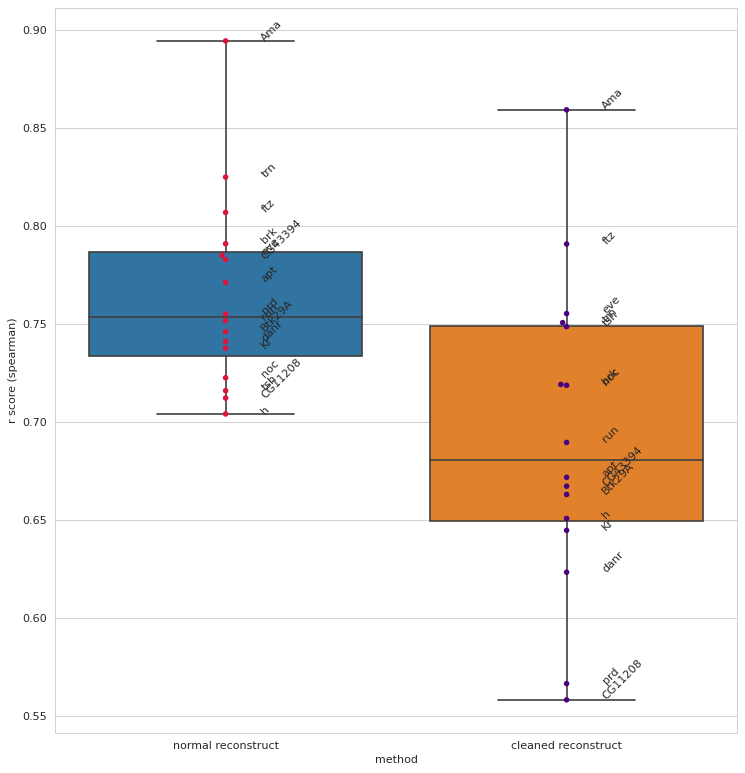

ground truth


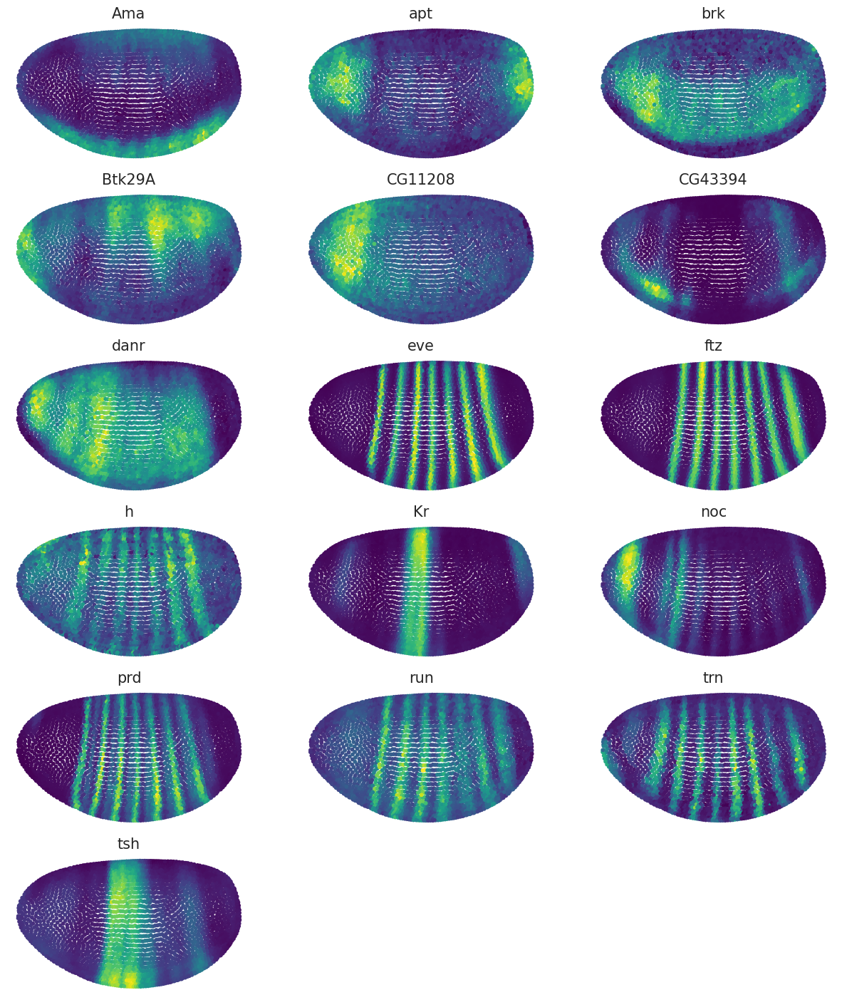

reconstruction


<Figure size 432x288 with 0 Axes>

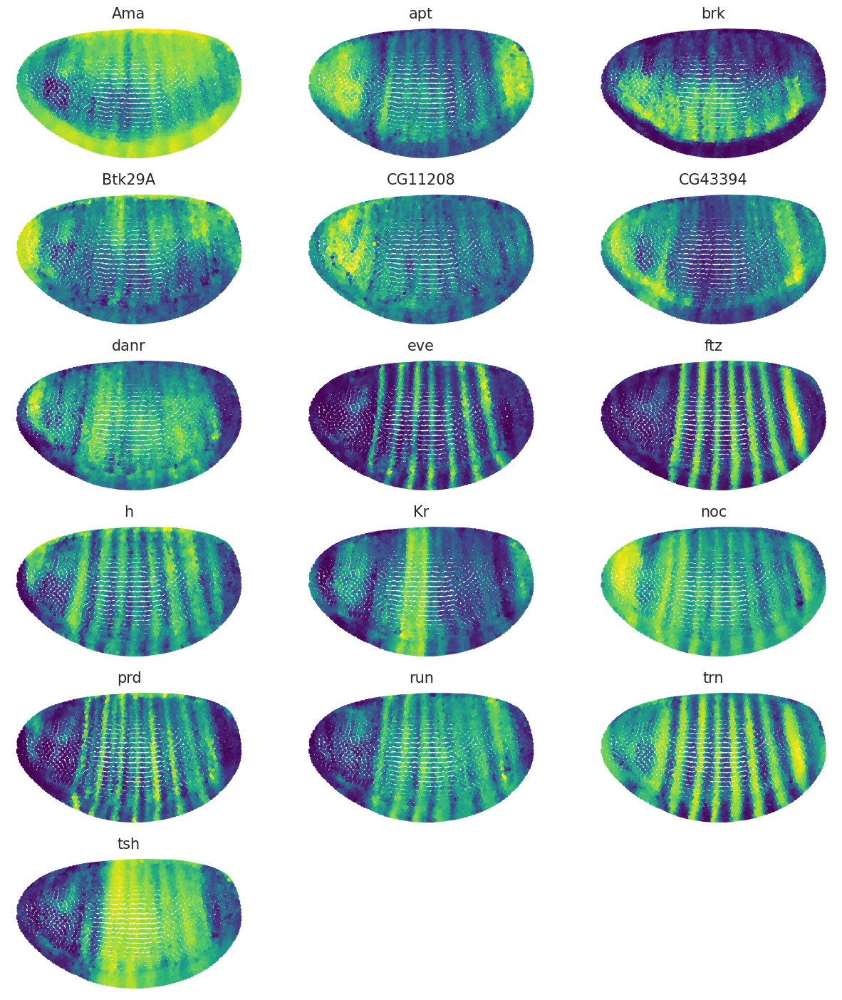

cleaning


<Figure size 432x288 with 0 Axes>

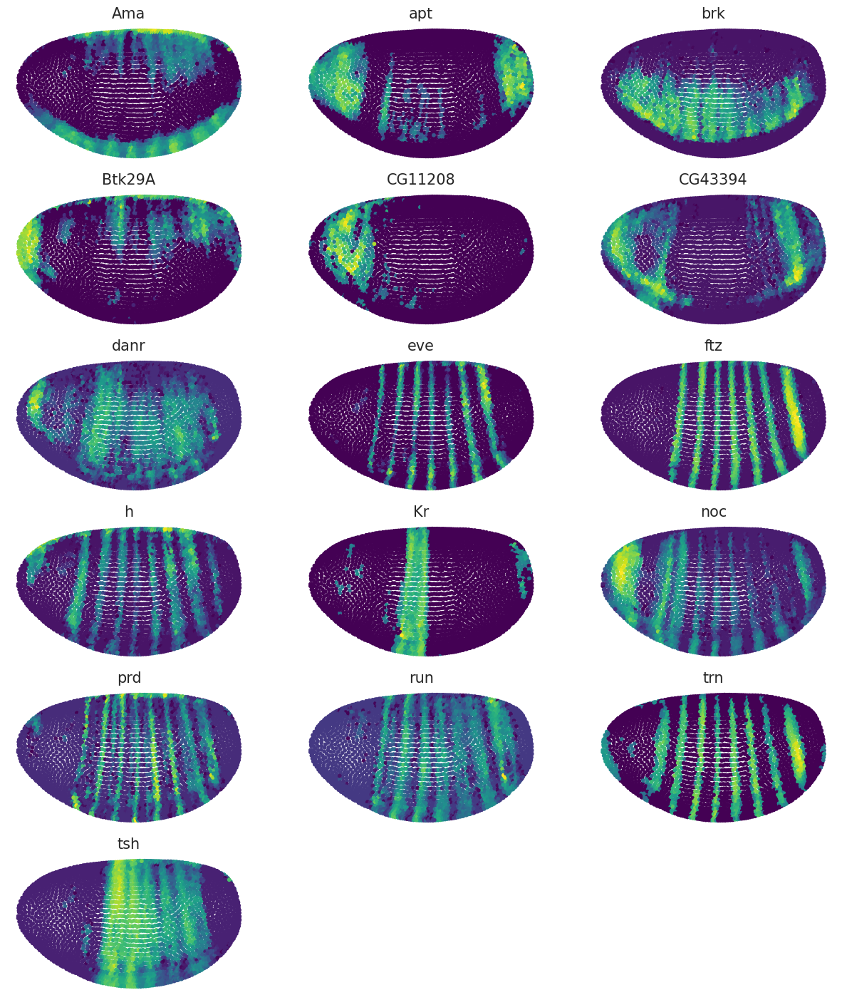

low scoring genes


<Figure size 432x288 with 0 Axes>

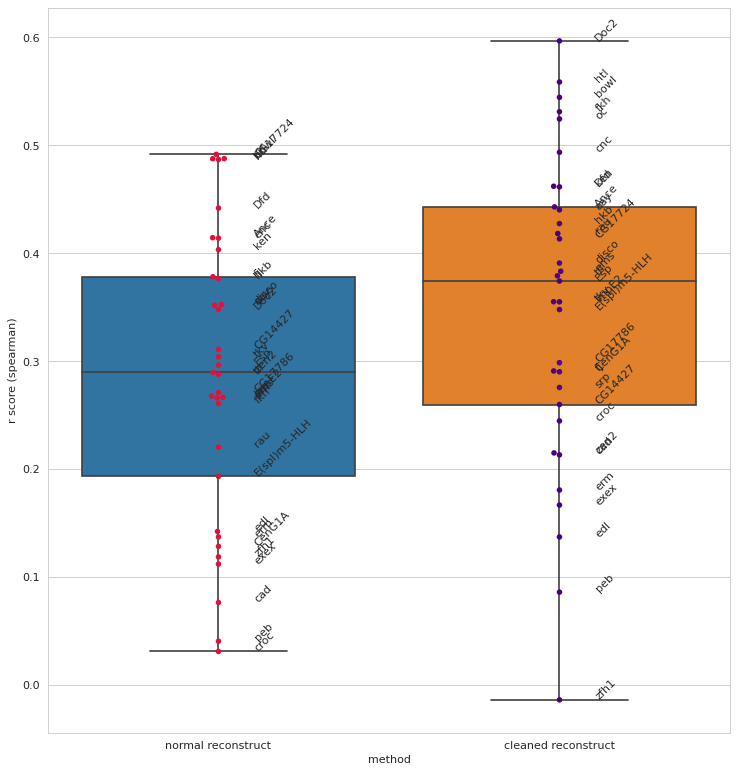

ground truth


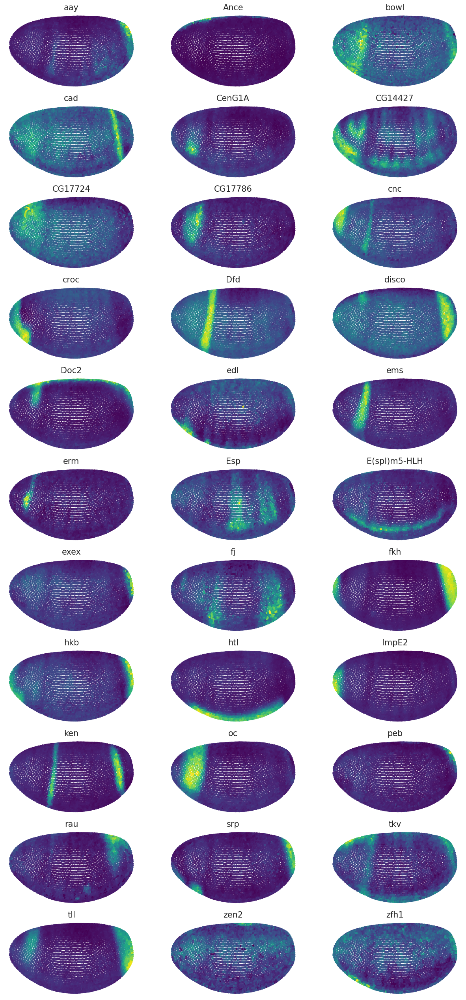

reconstruction


<Figure size 432x288 with 0 Axes>

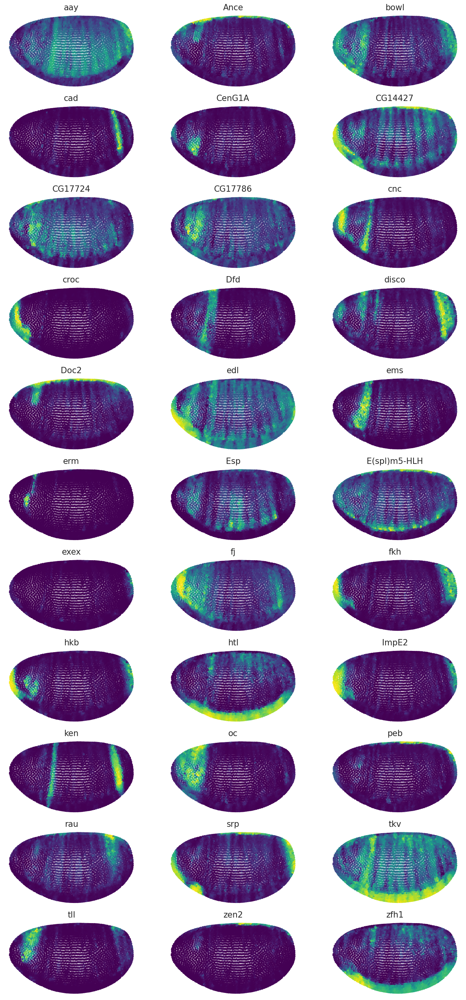

cleaning


<Figure size 432x288 with 0 Axes>

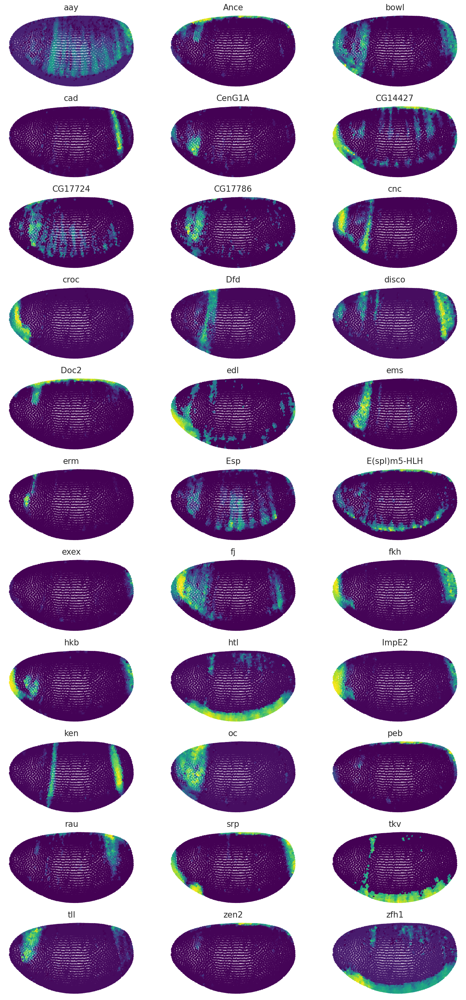

<Figure size 432x288 with 0 Axes>

In [72]:
plt.viridis()
# I think this should also be loopable

# pearson_invest_genes1
print("paper plotting genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, invest_genes1),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, invest_genes1),
                 filter_matrix_for_genes(spearman_corre_cleaned, invest_genes1)])
print("ground truth")
novosparc.pl.embedding(atlas, invest_genes1)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, invest_genes1)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, invest_genes1)

# high scoring genes
print("high scoring genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, high_score_genes),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, high_score_genes),
                 filter_matrix_for_genes(spearman_corre_cleaned, high_score_genes)])
print("ground truth")
novosparc.pl.embedding(atlas, high_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, high_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, high_score_genes)

# low scoring genes
print("low scoring genes")
box_swarm_label(filter_matrix_for_genes(spearman_corre_plt, low_score_genes),
                "r score (spearman)",
                [filter_matrix_for_genes(spearman_corre_reconstruction, low_score_genes),
                 filter_matrix_for_genes(spearman_corre_cleaned, low_score_genes)])

print("ground truth")
novosparc.pl.embedding(atlas, low_score_genes)
print("reconstruction")
novosparc.pl.embedding(dataset_reconst, low_score_genes)
print("cleaning")
novosparc.pl.embedding(dataset_reconst_postcleaned, low_score_genes)

## Cosine Similarity

In [73]:
len(r_values_recon)

84

### construct corre matrix

In [87]:
method_recon = ["normal reconstruct"] * len(atlas_genes)
cosin_sim_values_recon = sklearn.metrics.pairwise.cosine_similarity(expmtrx_truth_normed.T, exprmtrx_simplerecon_normed.T)
cosin_sim_values_recon_diag = np.diag(cosin_sim_values_recon)
cosin_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,cosin_sim_values_recon_diag, method_recon)),
                                    columns=["gene","r score (cosine)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
cosin_sim_values_clean = sklearn.metrics.pairwise.cosine_similarity(expmtrx_truth_normed.T,
                                                                    exprmtrx_recon_defaultGMM_normed.T)
cosin_sim_values_clean_diag = np.diag(cosin_sim_values_clean)
cosin_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,cosin_sim_values_clean_diag, method_clean)),
                                    columns=["gene","r score (cosine)","method"])

cosine_corre_plt = pd.concat([cosin_corre_reconstruction,cosin_corre_cleaned])

### plot corre all

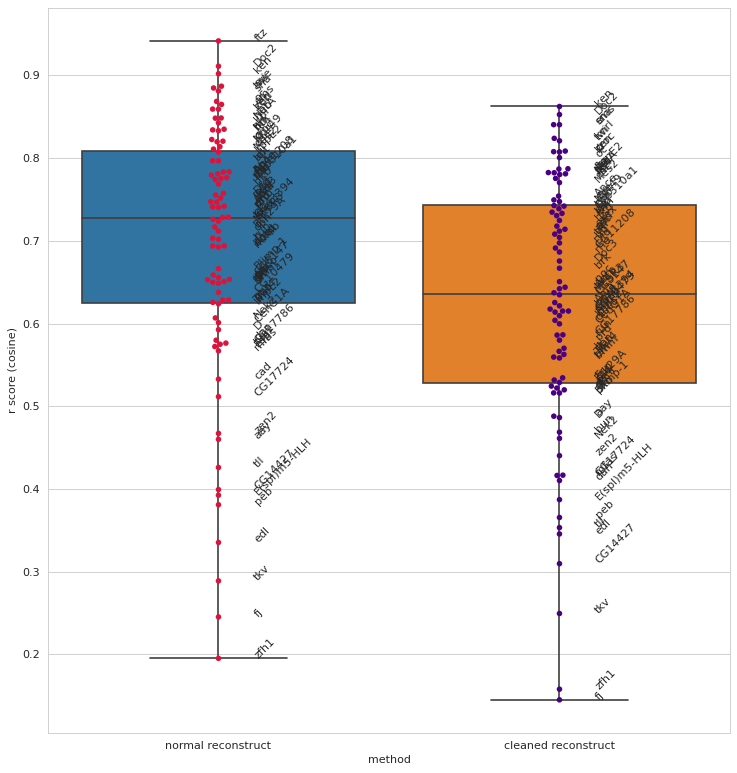

In [88]:
box_swarm_label(cosine_corre_plt,
                "r score (cosine)",
                [cosin_corre_reconstruction,cosin_corre_cleaned])

## Structural Similarity

### using whole matrix

In [92]:
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error


img = expmtrx_truth_normed
img_noise = exprmtrx_simplerecon_normed
img_const = exprmtrx_recon_defaultGMM_normed

mse_none = mean_squared_error(img, img)
ssim_none = ssim(img, img, data_range=img.max() - img.min())
print("SSM none:",ssim_none)

mse_noise = mean_squared_error(img, img_noise)
ssim_noise = ssim(img, img_noise, data_range=img_noise.max() - img_noise.min())
print("SSM reconstruction:", ssim_noise)

mse_const = mean_squared_error(img, img_const)
ssim_const = ssim(img, img_const, data_range=img_const.max() - img_const.min())
print("SSM cleaning:", ssim_const)


SSM none: 1.0
SSM reconstruction: 0.512973839209647
SSM cleaning: 0.2170253773603707


### using matrix subsets



## All measurements on scale&split version

median pearson; recon: 0.7271640722684104, clean:0.7345959900626189


<Figure size 432x288 with 0 Axes>

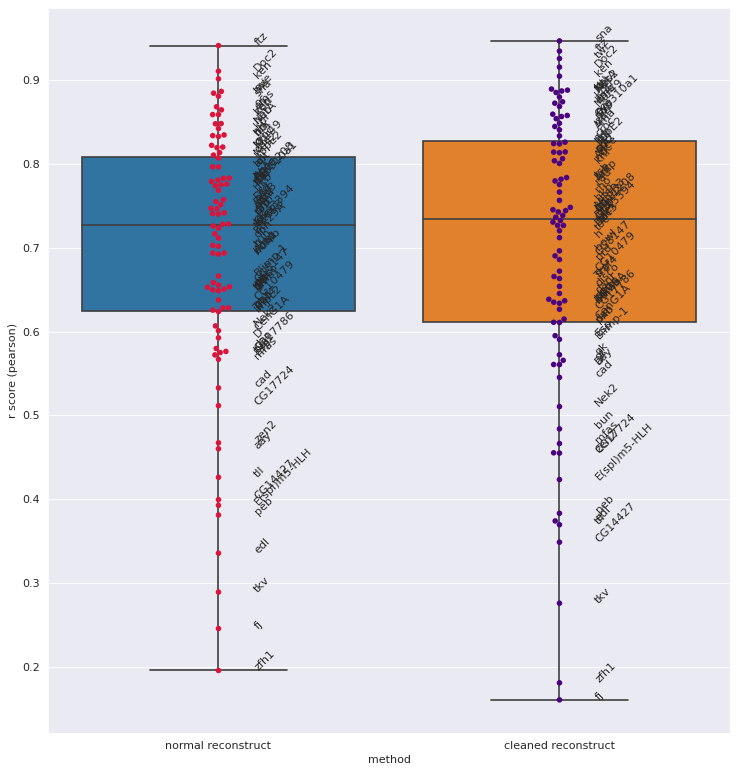

median spearman; recon: 0.559978483212084, clean:0.5413801036699281


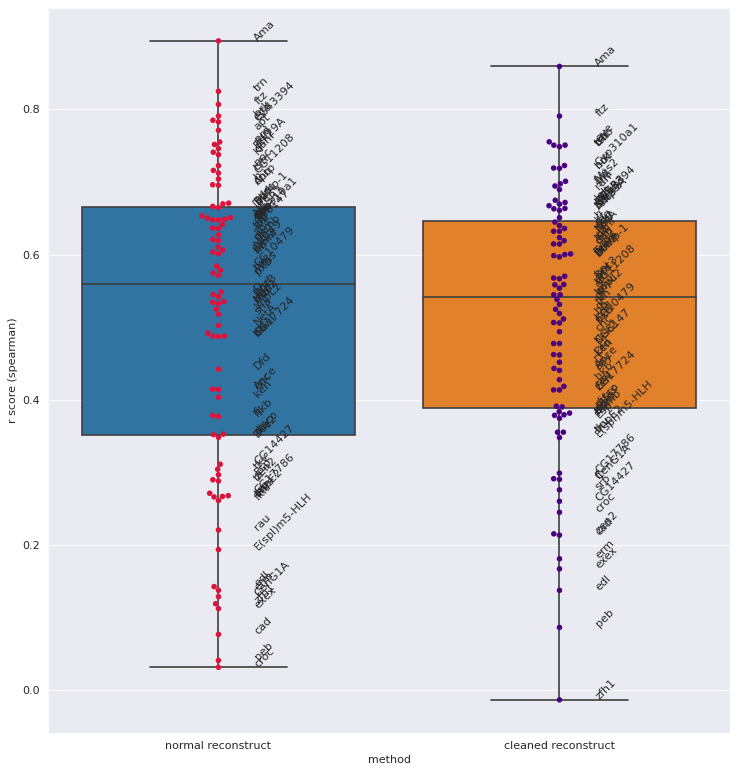

median cosine similarity; recon: 0.7271641492843628, clean:0.7346047163009644


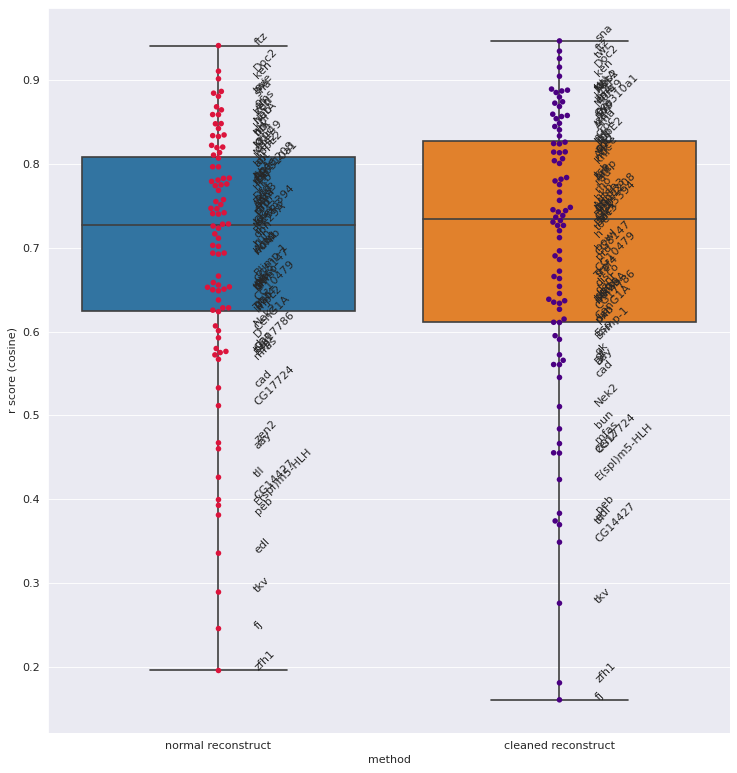

SSM none: 1.0
SSM reconstruction: 0.5129738888297013
SSM cleaning: 0.5358457769122714
median ssim gene-wise; recon: 0.24866614357058642, clean:0.2848138785379335


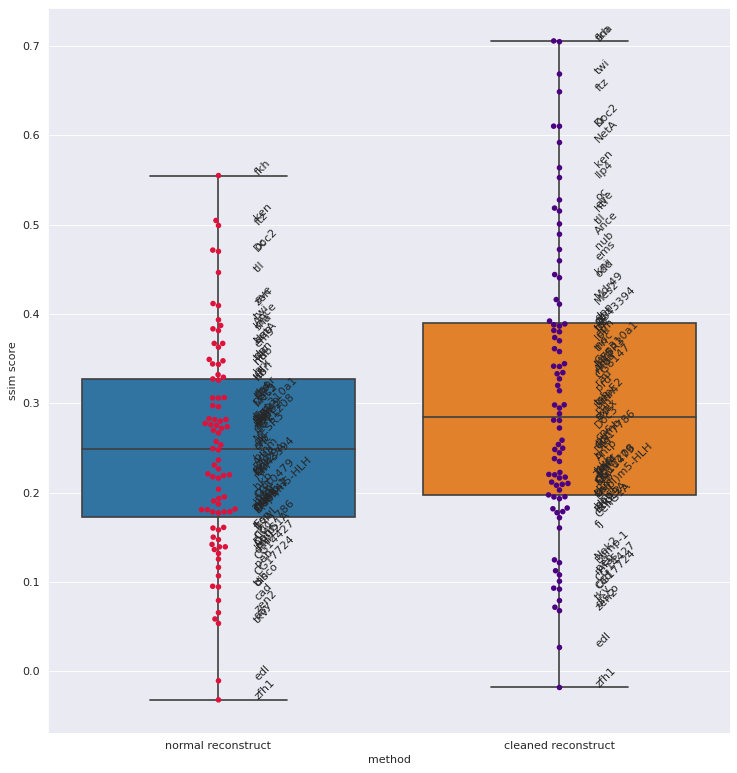

In [73]:
plt.viridis()
# pearson
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_pearson(expmtrx_truth_scaled, exprmtrx_simplerecon_scaled)
pearson_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes, r_values_recon, method_recon)),
                                            columns=["gene", "r score (pearson)", "method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_pearson(expmtrx_truth_scaled, exprmtrx_recon_defaultGMM_scaled)
pearson_corre_cleaned = pd.DataFrame(list(zip(atlas_genes, r_values_clean, method_clean)),
                                     columns=["gene", "r score (pearson)", "method"])

print(f"median pearson; recon: {np.median(r_values_recon)}, clean:{np.median(r_values_clean)}")
pearson_corre_plt = pd.concat([pearson_corre_reconstruction, pearson_corre_cleaned])
box_swarm_label(pearson_corre_plt, "r score (pearson)",
                [pearson_corre_reconstruction, pearson_corre_cleaned])

# spearman
method_recon = ["normal reconstruct"] * len(atlas_genes)
r_values_recon, mean_corre_recon = mean_spearman(expmtrx_truth_scaled, exprmtrx_simplerecon_scaled)
spearman_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes,r_values_recon, method_recon)),
                                    columns=["gene","r score (spearman)","method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
r_values_clean, mean_corre_clean = mean_spearman(expmtrx_truth_scaled, exprmtrx_recon_defaultGMM_scaled)
spearman_corre_cleaned = pd.DataFrame(list(zip(atlas_genes,r_values_clean, method_clean)),
                                    columns=["gene","r score (spearman)","method"])

print(f"median spearman; recon: {np.median(r_values_recon)}, clean:{np.median(r_values_clean)}")
spearman_corre_plt = pd.concat([spearman_corre_reconstruction,spearman_corre_cleaned])
box_swarm_label(spearman_corre_plt,
                "r score (spearman)",
                [spearman_corre_reconstruction,spearman_corre_cleaned])



# cosine
method_recon = ["normal reconstruct"] * len(atlas_genes)
cosin_sim_values_recon = sklearn.metrics.pairwise.cosine_similarity(expmtrx_truth_scaled.T, exprmtrx_simplerecon_scaled.T)
cosin_sim_values_recon_diag = np.diag(cosin_sim_values_recon)
cosin_corre_reconstruction = pd.DataFrame(list(zip(atlas_genes, cosin_sim_values_recon_diag, method_recon)),
                                          columns=["gene", "r score (cosine)", "method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
cosin_sim_values_clean = sklearn.metrics.pairwise.cosine_similarity(expmtrx_truth_scaled.T, exprmtrx_recon_defaultGMM_scaled.T)
cosin_sim_values_clean_diag = np.diag(cosin_sim_values_clean)
cosin_corre_cleaned = pd.DataFrame(list(zip(atlas_genes, cosin_sim_values_clean_diag, method_clean)),
                                   columns=["gene", "r score (cosine)", "method"])

print(f"median cosine similarity; recon: {np.median(cosin_sim_values_recon_diag)}, "
      f"clean:{np.median(cosin_sim_values_clean_diag)}")
cosine_corre_plt = pd.concat([cosin_corre_reconstruction, cosin_corre_cleaned])
box_swarm_label(cosine_corre_plt,
                "r score (cosine)",
                [cosin_corre_reconstruction, cosin_corre_cleaned])

# ssim - general

img = expmtrx_truth_scaled
img_noise = exprmtrx_simplerecon_scaled
img_const = exprmtrx_recon_defaultGMM_scaled

mse_none = mean_squared_error(img, img)
ssim_none = ssim(img, img, data_range=img.max() - img.min())
print("SSM none:",ssim_none)

mse_noise = mean_squared_error(img, img_noise)
ssim_noise = ssim(img, img_noise, data_range=img_noise.max() - img_noise.min())
print("SSM reconstruction:", ssim_noise)

mse_const = mean_squared_error(img, img_const)
ssim_const = ssim(img, img_const, data_range=img_const.max() - img_const.min())

print("SSM cleaning:", ssim_const)
# ssim - per gene

method_recon = ["normal reconstruct"] * len(atlas_genes)
ssim_values_recon, mean_ssim_recon = mean_ssim(expmtrx_truth_scaled, exprmtrx_simplerecon_scaled)

ssim_reconstruction = pd.DataFrame(list(zip(atlas_genes, ssim_values_recon, method_recon)),
                                          columns=["gene", "ssim score", "method"])

method_clean = ["cleaned reconstruct"] * len(atlas_genes)
ssim_values_clean, mean_ssim_clean = mean_ssim(expmtrx_truth_scaled, exprmtrx_recon_defaultGMM_scaled)
ssim_cleaned = pd.DataFrame(list(zip(atlas_genes, ssim_values_clean, method_clean)),
                                   columns=["gene", "ssim score", "method"])

print(f"median ssim gene-wise; recon: {np.median(ssim_values_recon)}, clean:{np.median(ssim_values_clean)}")
ssim_plt = pd.concat([ssim_reconstruction, ssim_cleaned])
box_swarm_label(ssim_plt,
                "ssim score",
                [ssim_reconstruction, ssim_cleaned])

In [72]:
cosin_sim_values_recon

array([[ 0.46004725, -0.06376916, -0.15820736, ..., -0.15185867,
        -0.08031423,  0.04636334],
       [-0.6030622 ,  0.74673045,  0.02578754, ...,  0.12010889,
         0.14848201,  0.74325824],
       [-0.12867503,  0.22771524,  0.7809284 , ...,  0.6093114 ,
         0.42090338, -0.16476427],
       ...,
       [-0.14240783,  0.3221875 ,  0.67732334, ...,  0.85916376,
         0.81376505, -0.24379812],
       [ 0.0161999 , -0.0129221 ,  0.26756158, ...,  0.3596807 ,
         0.46717766, -0.23295075],
       [-0.13571471,  0.08776297,  0.13052052, ...,  0.04298637,
         0.04576614,  0.19529255]], dtype=float32)

# Reconstruction without low scoring genes

1. decide for scoring method to choose
2. make an atlas wihout the low score genes
3. new reconstruction
4. new measurements of the similarity of *all atlas* genes again
5. maybe make additional plots of the questionable genes (those with screwed reconsturction, which were now reconstructed without having the atlas anchor)

## subsetting the atlas

In [82]:
wrong_reconstructed_genes = ["zfh1", "zen2", "fj", "aay", "edl", "E(spl)m5-HLH", "cad"]
atlas_77 = atlas[:,~ atlas.var_names.isin(wrong_reconstructed_genes)]
print(atlas.X.shape)
print(atlas_77.X.shape)

atlas_genes_77 = atlas_77.var.index.tolist()

expmtrx_truth = atlas.X # truth stays the same since I want to compare to the whole atlas

(3039, 84)
(3039, 77)


## reconstruction without failing genes

In [83]:
# calculate cost matrix
# params for smooth cost
num_neighbors_s = num_neighbors_t = 5

# params for linear cost
markers = list(set(atlas_genes_77).intersection(gene_names))
atlas_matrix = atlas_77.to_df()[markers].values
markers_idx = pd.DataFrame({'markers_idx': np.arange(num_genes)}, index=gene_names)
markers_to_use = np.concatenate(markers_idx.loc[markers].values)

# construct tissue object
tissue = novosparc.cm.Tissue(dataset=dataset, locations=locations_apriori)

tissue.setup_reconstruction(atlas_matrix=atlas_matrix,
                            markers_to_use=markers_to_use,
                            num_neighbors_s=num_neighbors_s,
                            num_neighbors_t=num_neighbors_t)

# dge_rep = None
tissue.setup_smooth_costs(dge_rep=dge_rep, num_neighbors_s=num_neighbors_s, num_neighbors_t=num_neighbors_t)

# compute optimal transport of cells to locations
alpha_linear = 0.8
epsilon = 5e-3
# tissue.dge = sparse.csr_matrix(tissue.dge)
tissue.reconstruct(alpha_linear=alpha_linear, epsilon=epsilon)

# reconstructed expression of individual genes
sdge = tissue.sdge
dataset_reconst_noFailGenes = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
dataset_reconst_noFailGenes.obsm['spatial'] = locations_apriori

subset_cols = []
for i, gene in enumerate(atlas_genes):
    if gene in dataset_reconst_noFailGenes.var_names:
        subset_cols.append(np.asarray(dataset_reconst_noFailGenes[:, gene].X).reshape(-1, 1))
exprmtrx_simplerecon = np.concatenate(subset_cols, axis=1)

Setting up for reconstruction ... done ( 3.68 seconds )
Setting up for reconstruction ... done ( 3.71 seconds )
Reconstructing spatial information with 77 markers: 1000 cells and 3039 locations ... 
Trying with epsilon: 5.00e-03
Trying with epsilon: 5.00e-03


/tmp/ipykernel_8980/3239183392.py:30: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  dataset_reconst_noFailGenes = sc.AnnData(pd.DataFrame(sdge.T, columns=gene_names))
/home/vfs/anaconda3/envs/rajewskyLab/lib/python3.9/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


truth


<Figure size 432x288 with 0 Axes>

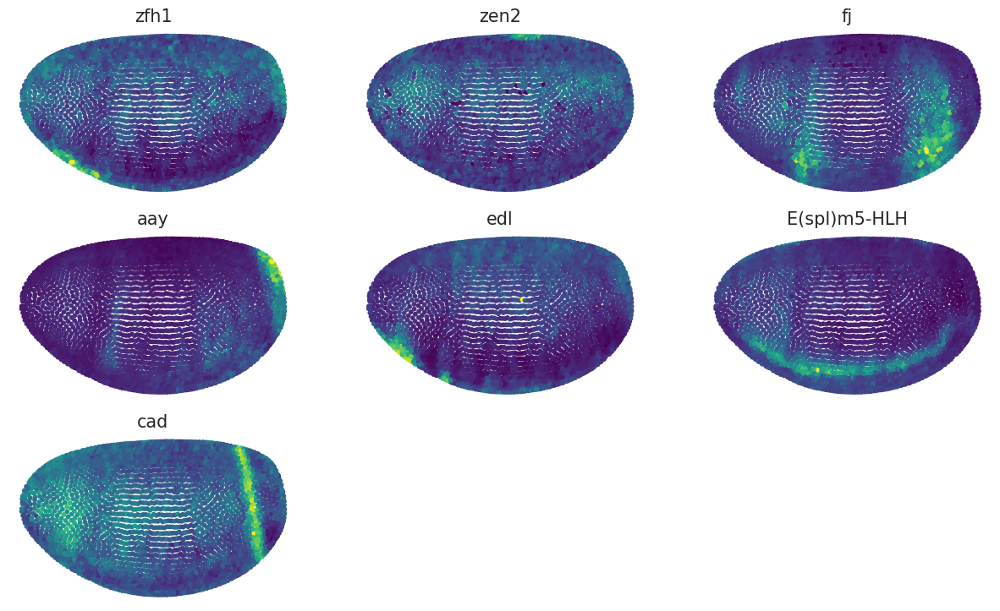

recon84


<Figure size 432x288 with 0 Axes>

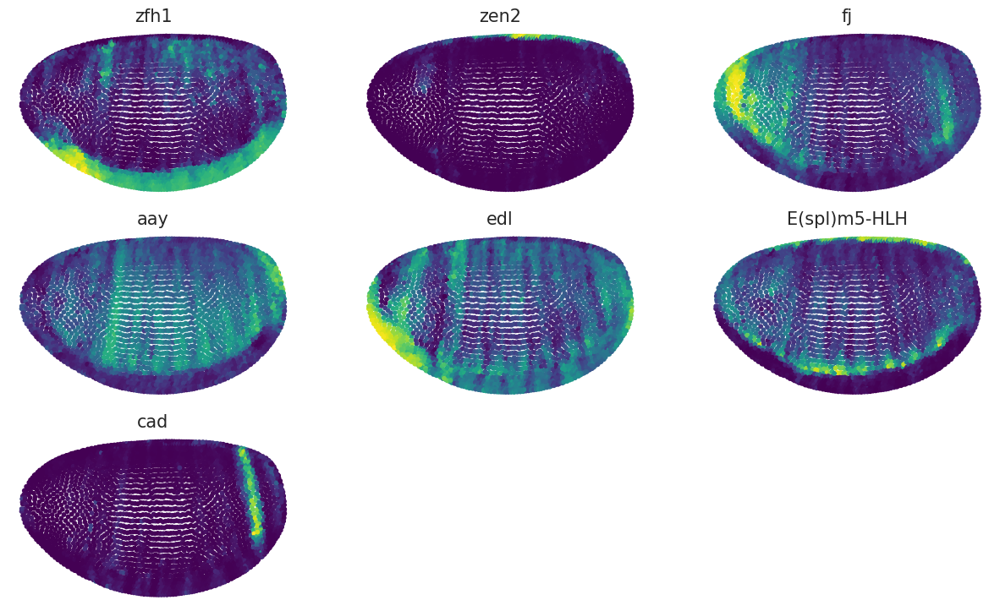

recon77


<Figure size 432x288 with 0 Axes>

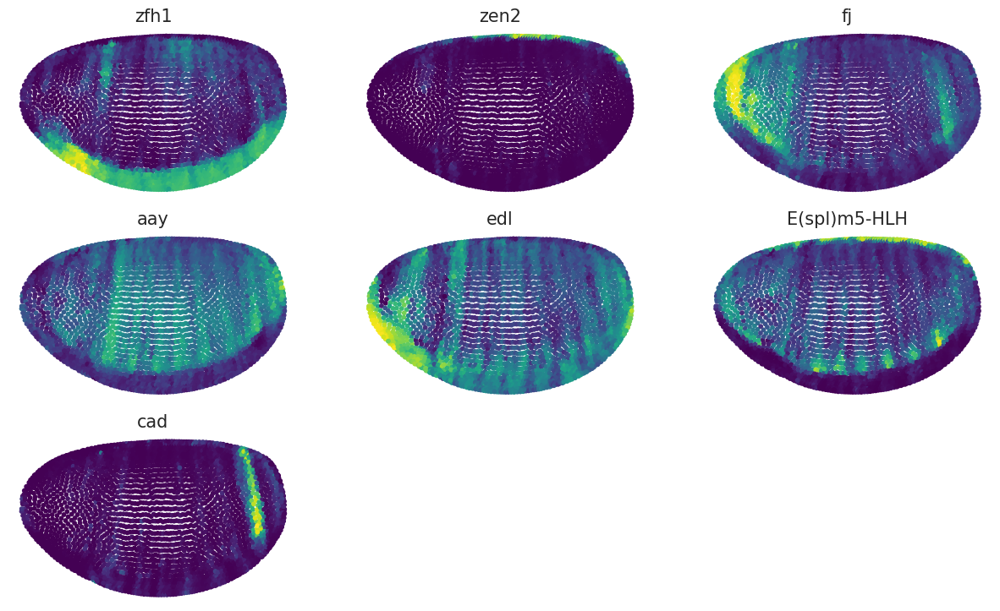

<Figure size 432x288 with 0 Axes>

In [87]:
# test
plt.viridis()
print("truth")
novosparc.pl.embedding(atlas, wrong_reconstructed_genes)
print("recon84")
novosparc.pl.embedding(dataset_reconst, wrong_reconstructed_genes)
print("recon77")
novosparc.pl.embedding(dataset_reconst_noFailGenes, wrong_reconstructed_genes)

# Plotting experiments

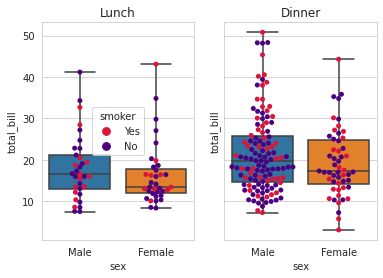

In [78]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

tips = sns.load_dataset("tips")

fig, axes = plt.subplots(ncols=2, sharex=True, sharey=True)

for ax, (n,grp) in zip(axes, tips.groupby("time")):
    sns.boxplot(x="sex", y="total_bill", data=grp, whis=np.inf, ax=ax)
    sns.swarmplot(x="sex", y="total_bill", hue="smoker", data=grp,
                  palette=["crimson","indigo"], ax=ax)
    ax.set_title(n)
axes[-1].get_legend().remove()
plt.show()

In [79]:
for x in range(10):
    print(x)
    if x > 3:
        break
else:
    print("a")

0
1
2
3
4
